In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scanpy as sc
import anndata as ad
from matplotlib import rcParams
import irene_utils as utils
import os
from tqdm import tqdm

In [2]:
srt_data_folder_path = "../datasets/srt_data" # spatially resolved transcriptomics data
srt_data_bronze_folder_path = f"{srt_data_folder_path}/bronze"
srt_data_silver_folder_path = f"{srt_data_folder_path}/silver"
srt_data_gold_folder_path = f"{srt_data_folder_path}/gold"
srt_data_irene_folder_path = f"{srt_data_folder_path}/irene_temp"
dataset = "nanostring_cosmx_human_nsclc"

# preprocess all

In [3]:
# merge raw counts
adata_sample_list = []
samples = os.listdir(f'{srt_data_gold_folder_path}')
samples = [sample for sample in samples if 'batch' in sample]

for sample in samples:
    adata_sample_list.append(sc.read_h5ad(f'{srt_data_gold_folder_path}/{sample}'))
adata = ad.concat(adata_sample_list, join="inner")
adata.obs_names = adata.obs['sample'].astype(str)+'_'+adata.obs['fov'].astype(str)+'_'+adata.obs['cell_ID'].astype(str)

# qc
sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)

# logcpm
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

print(adata)
adata.obs.head(3)

/Users/irene.bonafonte/miniforge3/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 702760 × 960
    obs: 'fov', 'cell_ID', 'sample', 'sample_id', 'replicate_id', 'n_genes_by_counts', 'total_counts'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p'
    obsm: 'spatial'
    layers: 'counts'


,fov,cell_ID,sample,sample_id,replicate_id,n_genes_by_counts,total_counts
lung9_rep1_1_2,1,2,lung9_rep1,9,1,50,56.0
lung9_rep1_1_7,1,7,lung9_rep1,9,1,61,75.0
lung9_rep1_1_8,1,8,lung9_rep1,9,1,63,76.0


In [4]:
annotations = pd.read_csv(f"../datasets/srt_data/irene_temp/nanostring_cosmx_human_nsclc/metadata_giotto.csv", index_col=0)
annotations

,cell_ID,fov,Area,AspectRatio,Width,Height,Mean.CD298,Max.CD298,Mean.G,Max.G,...,Panel,Diversity,totalcounts,log10totalcounts,background,remove_flagged_cells,patient,cell_type,niche,prop_tumor_in_100_neighbors
1,c_1_1_1,1,1259,1.34,47,35,3473,7354,715,5755,...,980p,19,23,1.361728,0.004956,False,Lung5,mDC,plasmablast-enriched stroma,0.09
2,c_1_1_2,1,3723,1.45,87,60,3895,13832,18374,53158,...,980p,23,26,1.414973,0.005603,False,Lung5,endothelial,stroma,0.00
3,c_1_1_3,1,2010,1.62,68,42,2892,6048,3265,37522,...,980p,51,74,1.869232,0.015946,False,Lung5,endothelial,stroma,0.01
4,c_1_1_4,1,3358,0.47,48,102,6189,16091,485,964,...,980p,48,60,1.778151,0.012929,False,Lung5,pDC,stroma,0.00
5,c_1_1_5,1,1213,1.00,38,38,8138,19281,549,874,...,980p,39,52,1.716003,0.011205,False,Lung5,macrophage,stroma,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
771232,c_8_20_3999,20,1314,1.02,45,44,7430,9572,370,962,...,980p,87,135,2.130334,0.029091,False,Lung13,T CD4 memory,immune,0.34
771233,c_8_20_4000,20,1549,1.71,60,35,8362,11209,161,2024,...,980p,60,74,1.869232,0.015946,False,Lung13,T CD4 memory,immune,0.30
771234,c_8_20_4001,20,2829,2.75,99,36,5158,10180,634,2166,...,980p,69,102,2.008600,0.021980,False,Lung13,macrophage,macrophages,0.41
771235,c_8_20_4003,20,1156,2.12,55,26,6339,9804,211,570,...,980p,30,31,1.491362,0.006680,False,Lung13,T CD4 memory,macrophages,0.11


In [5]:
annotations = pd.read_csv(f"../datasets/srt_data/irene_temp/nanostring_cosmx_human_nsclc/metadata_giotto.csv", index_col=0)
annotations['Run_Tissue_name'] = annotations['Run_Tissue_name'].str.lower().values
annotations['cell_ID'] = annotations.cell_ID.apply(lambda x: x.split('_')[3])
annotations.index = annotations['Run_Tissue_name']+'_'+annotations['fov'].astype(str)+'_'+annotations['cell_ID'].values
transfer_columns = ['cell_type','niche','Area','AspectRatio','Width','Height','Mean.CD298','Mean.DAPI','Run_name','Dash','background']
annotations = annotations[transfer_columns]
adata = adata[adata.obs_names.isin(annotations.index)]
adata.obs[transfer_columns] = annotations.loc[adata.obs_names,transfer_columns].values
adata.obs = adata.obs.astype({'background': 'float', 'Area': 'float', 'Width': 'float', 'Height': 'float', 'Mean.CD298': 'float', 'Mean.DAPI': 'float', 'AspectRatio': 'float'})
adata.obs

# add broader cell types
adata.obs['cell_type_simplified'] = adata.obs['cell_type'].astype(str)
adata.obs.loc[adata.obs['cell_type'].apply(lambda x: 'T' in x),'cell_type_simplified'] = 'NK/T cell'
adata.obs.loc[adata.obs['cell_type'].apply(lambda x: 'tumor' in x),'cell_type_simplified'] = 'tumor'
adata.obs.loc[adata.obs['cell_type'] == 'NK','cell_type_simplified'] = 'NK/T cell'
adata.obs.loc[adata.obs['cell_type'].apply(lambda x: 'DC' in x),'cell_type_simplified'] = 'DC'
adata.obs.loc[(adata.obs['cell_type'] == 'monocyte') | (adata.obs['cell_type'] == 'macrophage') | (adata.obs['cell_type_simplified'] == 'DC'),'cell_type_simplified'] = 'myeloid'

/var/folders/9k/rsnwv_zs49n5zryyfc4myl9d6b36ql/T/ipykernel_23931/846653402.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[transfer_columns] = annotations.loc[adata.obs_names,transfer_columns].values


In [6]:
adata

AnnData object with n_obs × n_vars = 702199 × 960
    obs: 'fov', 'cell_ID', 'sample', 'sample_id', 'replicate_id', 'n_genes_by_counts', 'total_counts', 'cell_type', 'niche', 'Area', 'AspectRatio', 'Width', 'Height', 'Mean.CD298', 'Mean.DAPI', 'Run_name', 'Dash', 'background', 'cell_type_simplified'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p'
    obsm: 'spatial'
    layers: 'counts'

## qc

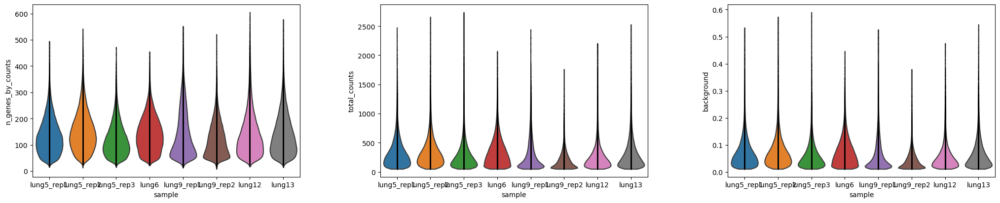

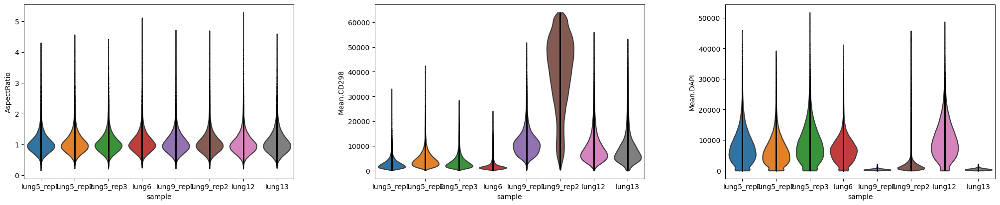

In [7]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'background'], jitter=0, multi_panel=True, groupby='sample', n_cols=2)
sc.pl.violin(adata, ['AspectRatio', 'Mean.CD298', 'Mean.DAPI'], jitter=0, multi_panel=True, groupby='sample', n_cols=2)

(97487, 960)


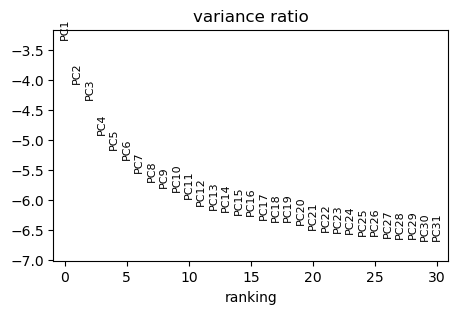

/Users/irene.bonafonte/miniforge3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


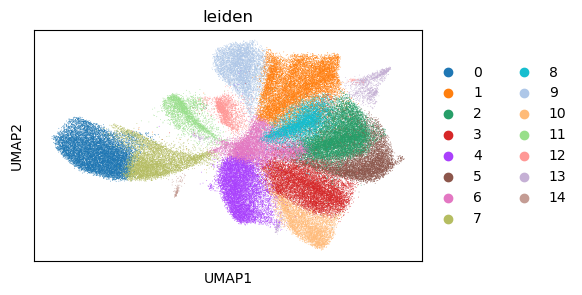

/Users/irene.bonafonte/miniforge3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


KeyError: 'fov2'

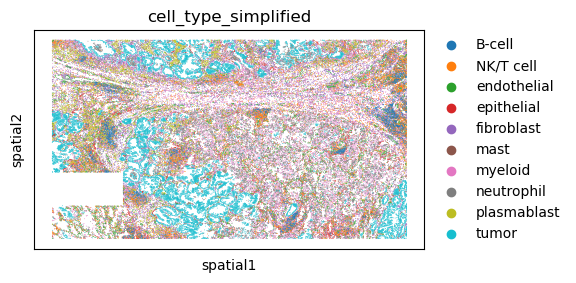

In [182]:
adata_lung5_r2 = utils.preprocess_subsample(adata, ['lung5_rep2'], n_neighbours=30, n_pcs=30, plot_covariates=[])
sc.pl.embedding(adata_lung5_r2, basis="spatial", color=["cell_type_simplified", "fov2", "cell_type"], ncols=2)

# sample 5 replicate 3

## preprocess

(91691, 960)


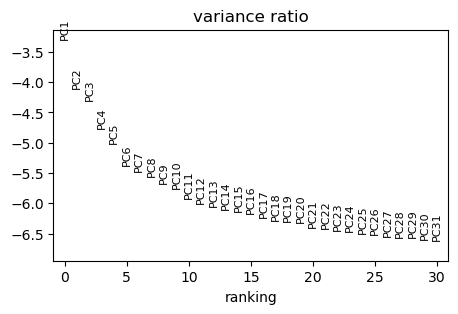

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
/Users/irene.bonafonte/miniforge3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


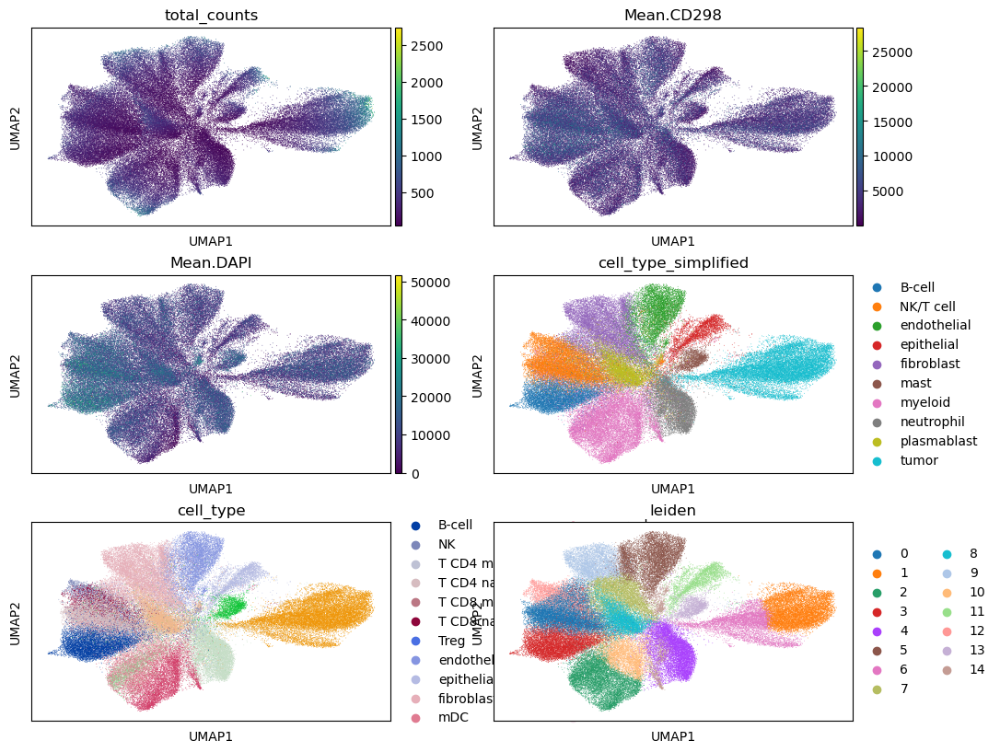

In [8]:
adata_lung5_r3 = utils.preprocess_subsample(adata, ['lung5_rep3'], n_neighbours=30, n_pcs=30, plot_covariates=['total_counts','Mean.CD298','Mean.DAPI','cell_type_simplified','cell_type'])

## qc

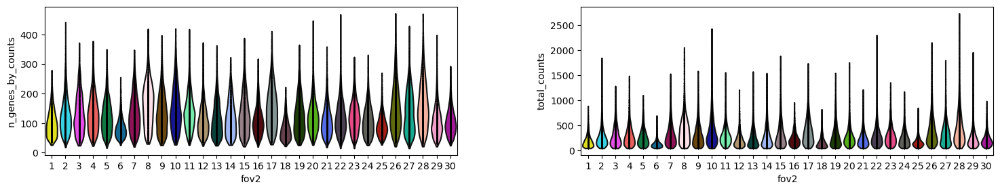

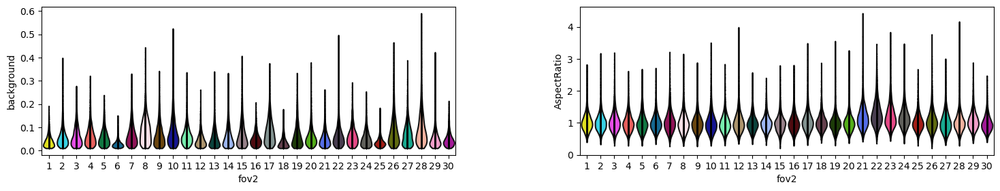

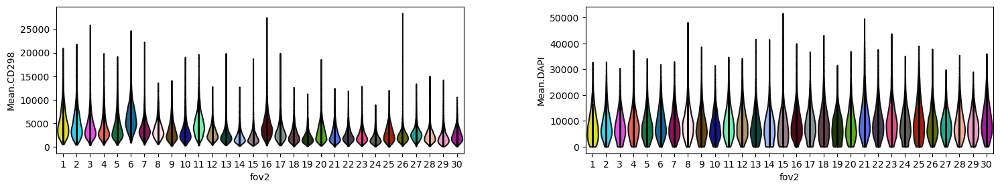

In [9]:
rcParams['figure.figsize'] = (7, 3)
adata_lung5_r3.obs['fov2'] = adata_lung5_r3.obs['fov'].astype(str)
sc.pl.violin(adata_lung5_r3, ['n_genes_by_counts', 'total_counts'], jitter=0, multi_panel=True, groupby='fov2')
sc.pl.violin(adata_lung5_r3, ['background', 'AspectRatio'], jitter=0, multi_panel=True, groupby='fov2')
sc.pl.violin(adata_lung5_r3, ['Mean.CD298', 'Mean.DAPI'], jitter=0, multi_panel=True, groupby='fov2')

## cell props

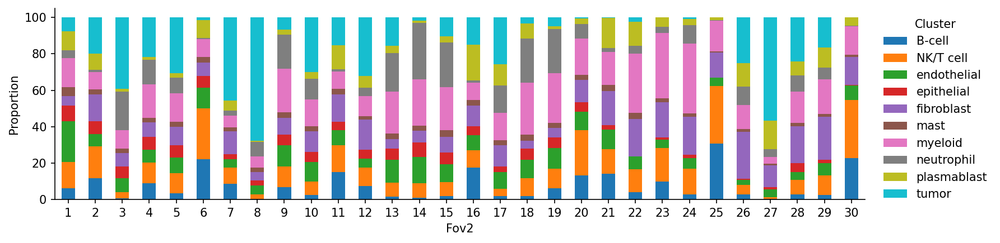

In [10]:
sizes = adata_lung5_r3.obs.groupby(['cell_type_simplified', 'fov2']).size()
props = sizes.groupby(level=1, group_keys=False).apply(lambda x: 100 * x / x.sum()).reset_index() 
props = props.pivot(columns='fov2', index='cell_type_simplified').T
props.index = props.index.droplevel(0)
props.fillna(0, inplace=True)
rcParams['figure.figsize'] = (12, 3)
_ = utils.plot_cluster_proportions(props)

## visualize images

/Users/irene.bonafonte/miniforge3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


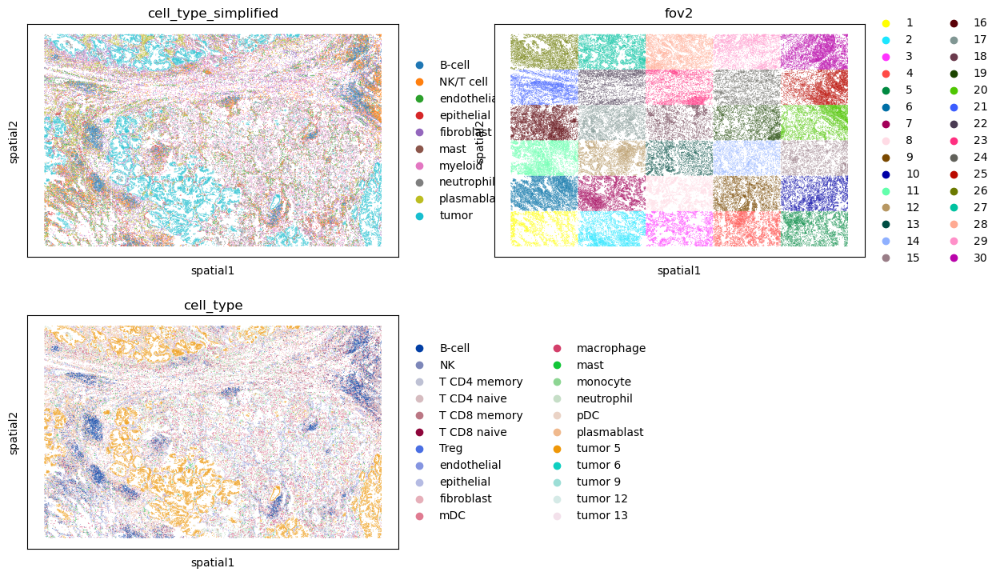

In [11]:
rcParams['figure.figsize'] = (6, 4)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=["cell_type_simplified", "fov2", "cell_type"], ncols=2)

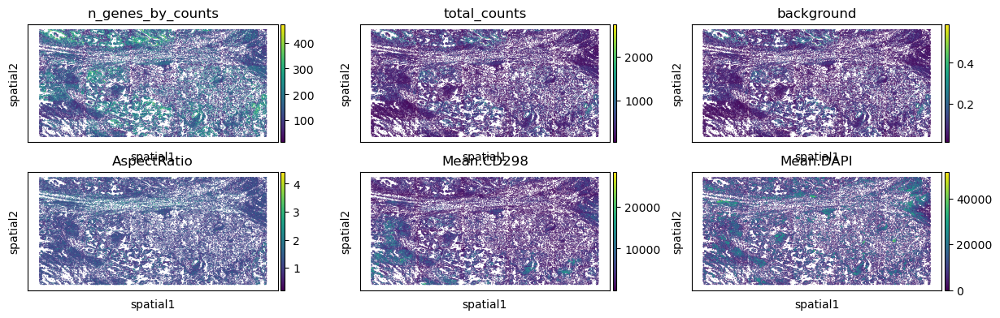

In [12]:
rcParams['figure.figsize'] = (4, 2)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=['n_genes_by_counts', 'total_counts', 'background', 'AspectRatio', 'Mean.CD298', 'Mean.DAPI'], ncols=3)

## differential genes between fovs with batches

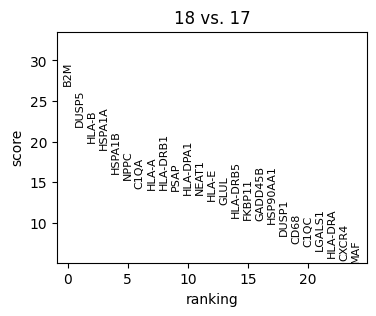

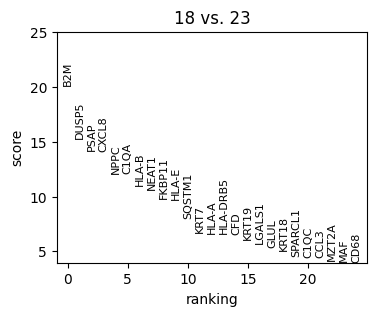

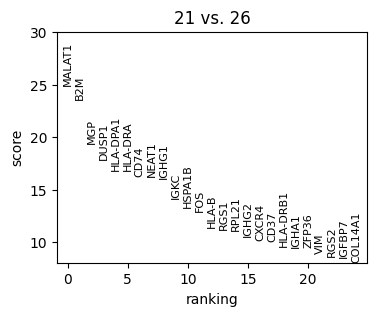

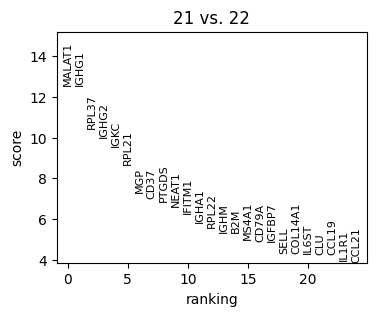

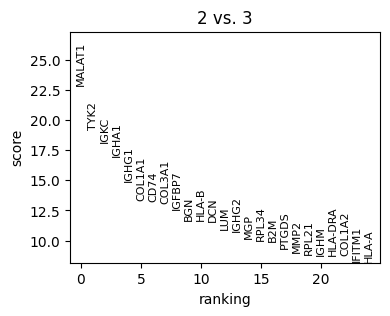

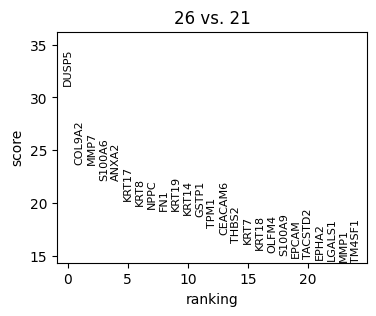

In [41]:
# strong batch effects in 26 vs 21, 18 vs 17, 18 vs 23, 21 vs 22, 2 vs 3
rcParams['figure.figsize'] = (4, 3)
for batch in [('18','17'), ('18','23'), ('21','26'), ('21','22'), ('2','3'), ('26','21')]:
    sc.tl.rank_genes_groups(adata_lung5_r3, 'fov2', method='wilcoxon', groups=[batch[0]], reference=batch[1])
    sc.pl.rank_genes_groups(adata_lung5_r3, n_genes=25, sharey=False)

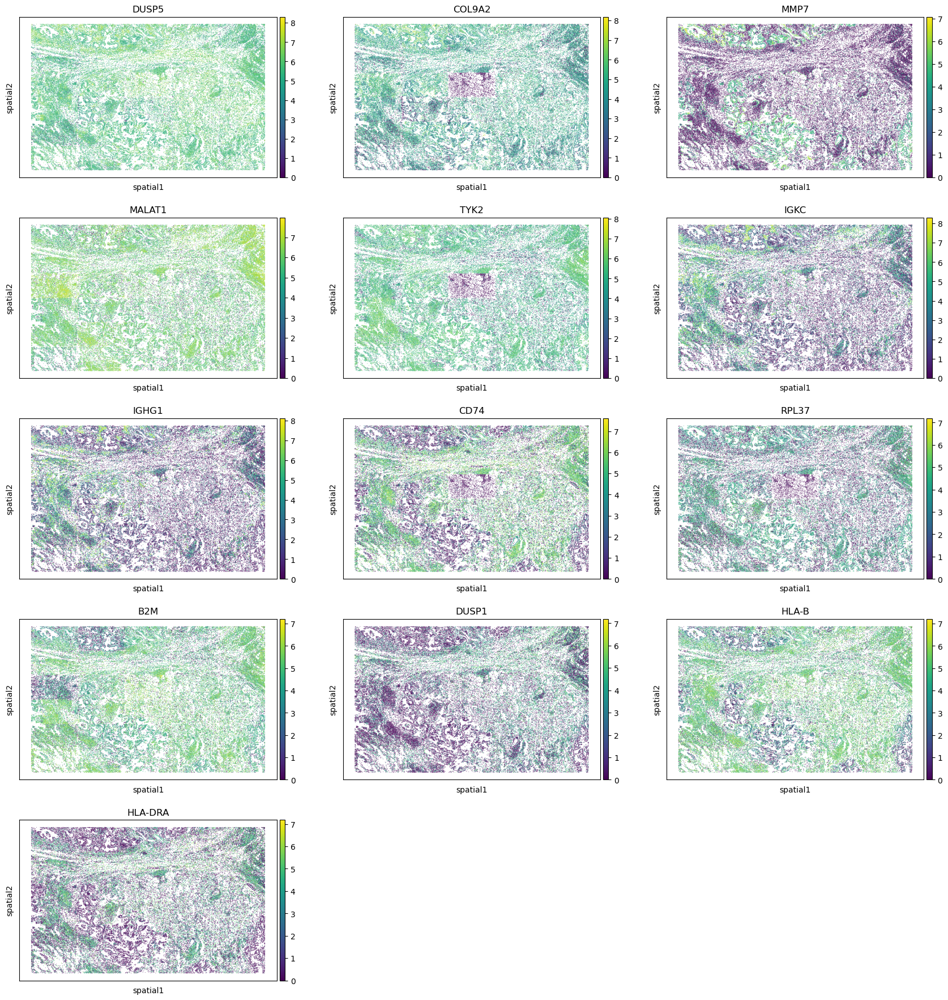

In [13]:
batch_genes=['DUSP5','COL9A2','MMP7','MALAT1','TYK2','IGKC','IGHG1','CD74','RPL37','B2M','DUSP1','HLA-B','HLA-DRA']
rcParams['figure.figsize'] = (6, 4)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=batch_genes, ncols=3)

## missing coordinates

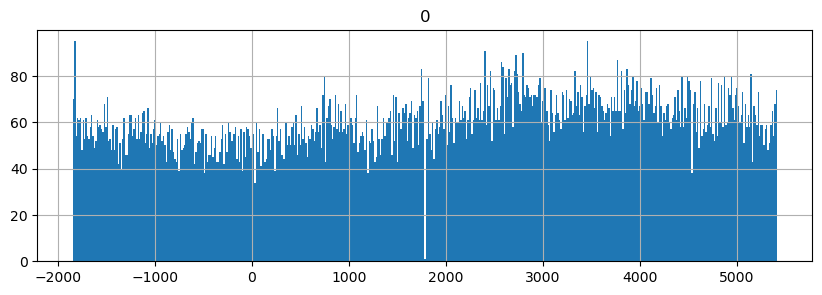

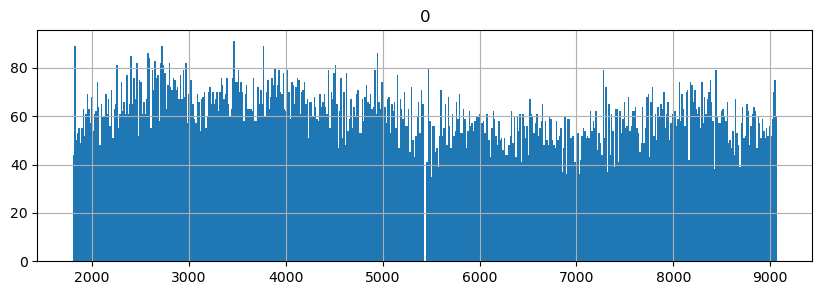

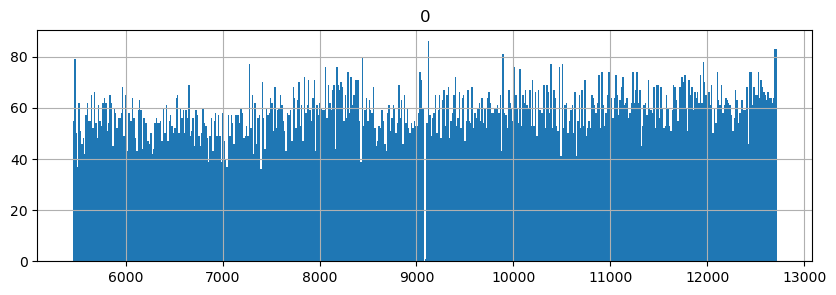

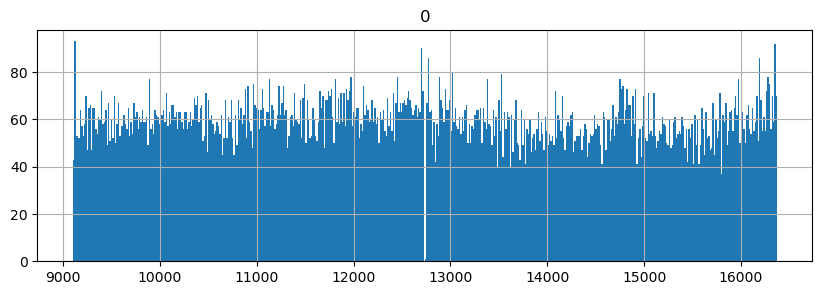

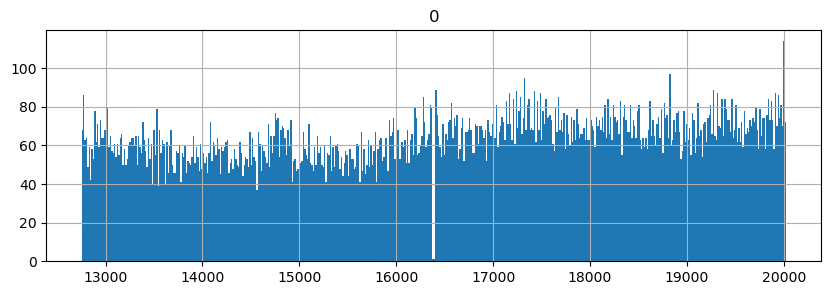

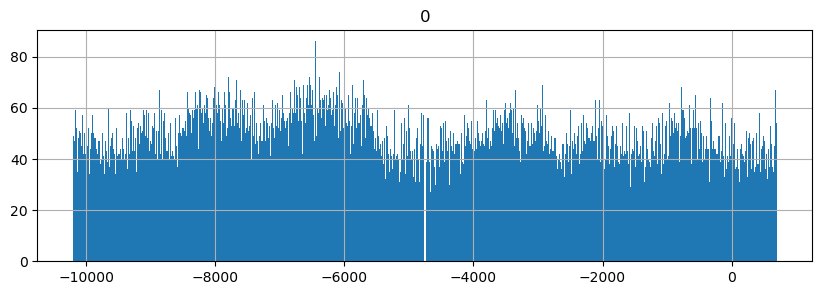

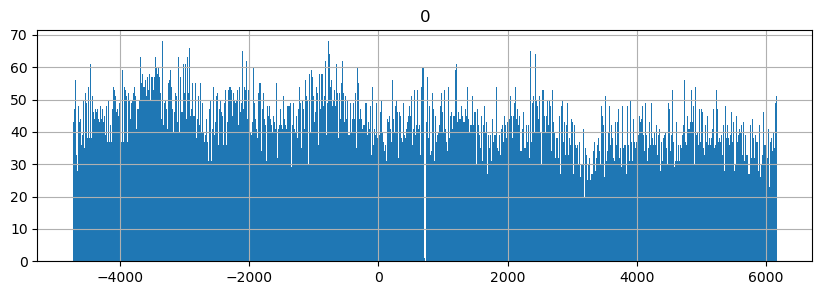

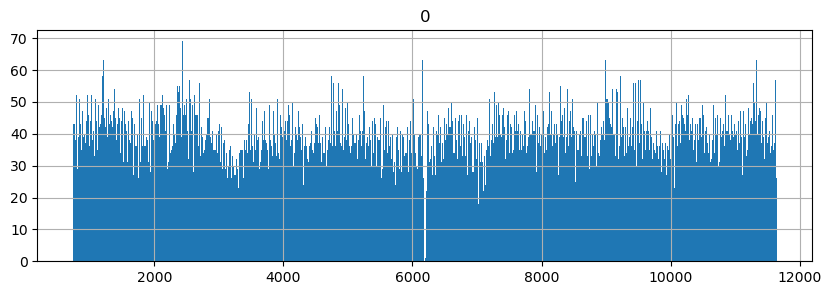

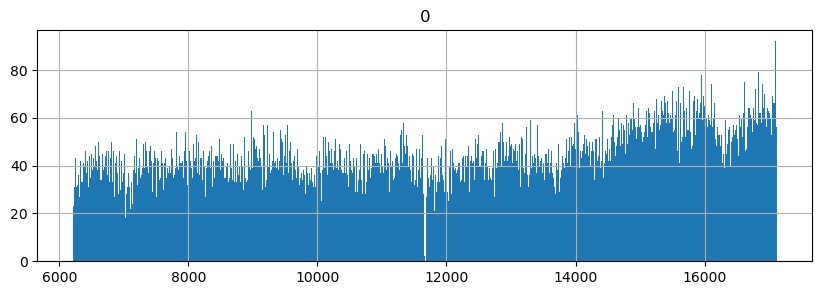

In [15]:
rcParams['figure.figsize'] = (10, 3)
coord = adata_lung5_r3.obsm['spatial']
fov = adata_lung5_r3.obs['fov']

for row in range(5):
    up = [(row)*5 + i + 1 for i in range(5)]
    down = [(row+1)*5 + i + 1 for i in range(5)]
    pd.DataFrame(coord[fov.isin(up+down),1]).hist(bins=500)
    
for col in range(4):
    left = [i+1 for i in range(col,30,5)]
    right = [i+1 for i in range(col+1,30,5)]
    pd.DataFrame(coord[fov.isin(left+right),0]).hist(bins=800)

## changes in mean/var between fovs

### var

In [ ]:
fovs = adata_lung5_r3.obs.fov.unique()
genes = adata_lung5_r3.var_names
variance_ratio = np.zeros((len(genes), len(fovs))) + 1000
ncols = 5

for j, fov in tqdm(enumerate(fovs)):
    
    # define neighbour fovs
    if (fov-1)%ncols == 0:
        neighbours = [1, -ncols, ncols]
    elif fov%ncols == 0:
        neighbours = [-1, -ncols, ncols]
    elif fov in [x+1 for x in range(ncols)]:
        neighbours = [-1, 1, ncols]
    elif fov in [x+1 for x in range(max(fovs)-ncols, max(fovs))]:
        neighbours = [-1, 1, -ncols]
    else:
        neighbours = [-1, 1, -ncols, ncols]
    neighbours = [fov + x for x in neighbours]
    
    fov_cells = adata_lung5_r3.obs.fov == fov
    
    for n in neighbours:
        fn_cells = adata_lung5_r3.obs.fov.isin([fov,n])
        
        for i, gene in enumerate(genes):
            non_zero = np.array((adata_lung5_r3.raw[:,gene].X.todense() != 0).T)[0]
            fov_var = adata_lung5_r3[fov_cells & non_zero,gene].X.var().tolist()
            fn_var = adata_lung5_r3[fn_cells & non_zero,gene].X.var().tolist()
            
            if fov_var > 0:
                variance_ratio[i,j] = min(fn_var/fov_var, variance_ratio[i,j])
                
            else:
                variance_ratio[i,j] = 0
            
variance_ratio = pd.DataFrame(variance_ratio, index=genes, columns=fovs)
max_var, mean_var = variance_ratio.max(axis=1).values, variance_ratio.mean(axis=1).values
variance_ratio['max'], variance_ratio['mean'] = max_var, mean_var
variance_ratio.sort_values(by='max', ascending=False)

In [ ]:
rcParams['figure.figsize'] = (4, 2)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=variance_ratio.sort_values(by='max', ascending=False).head(20).index.values, ncols=5)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=variance_ratio.sort_values(by='mean', ascending=False).head(20).index.values, ncols=5)

### mean

In [105]:
ncols = 5
fovs = adata_lung5_r3.obs.fov.unique()
genes = adata_lung5_r3.var_names
mean_ratio = np.zeros((len(genes), len(fovs))) + 1000

for j, fov in tqdm(enumerate(fovs)):
    
    # define neighbour fovs
    if (fov-1)%ncols == 0:
        neighbours = [1, -ncols, ncols]
    elif fov%ncols == 0:
        neighbours = [-1, -ncols, ncols]
    elif fov in [x+1 for x in range(ncols)]:
        neighbours = [-1, 1, ncols]
    elif fov in [x+1 for x in range(max(fovs)-ncols, max(fovs))]:
        neighbours = [-1, 1, -ncols]
    else:
        neighbours = [-1, 1, -ncols, ncols]
    neighbours = [fov + x for x in neighbours]
    
    fov_cells = adata_lung5_r3.obs.fov == fov
    
    for n in neighbours:
        fn_cells = adata_lung5_r3.obs.fov.isin([fov,n])
        
        for i, gene in enumerate(genes):
            fov_mean = adata_lung5_r3[fov_cells,gene].X.mean().tolist()
            fn_mean = adata_lung5_r3[fn_cells,gene].X.mean().tolist()
            mean_ratio[i,j] = min(abs(fn_mean - fov_mean), mean_ratio[i,j])

            
mean_ratio = pd.DataFrame(mean_ratio, index=genes, columns=fovs)
max_var, mean_var = mean_ratio.max(axis=1).values, mean_ratio.mean(axis=1).values
mean_ratio['max'], mean_ratio['mean'] = max_var, mean_var
mean_ratio.sort_values(by='max', ascending=False)

,1,2,3,4,5,6,7,8,9,10,...,23,24,25,26,27,28,29,30,max,mean
TYK2,0.245562,0.255282,0.105749,0.160330,0.083536,0.294082,0.274714,0.259795,0.147364,0.157870,...,0.137170,0.146036,0.280436,0.193078,0.221422,0.156707,0.062396,0.156200,1.129953,0.200978
COL9A2,0.432899,0.206923,0.109811,0.142292,0.186098,0.184655,0.041614,0.103030,0.034175,0.071497,...,0.056246,0.072496,0.205371,0.085438,0.155669,0.017991,0.044486,0.176022,1.111843,0.148819
HLA-C,0.026128,0.118258,0.200689,0.025607,0.155303,0.016596,0.065039,0.229757,0.017325,0.127695,...,0.069318,0.165294,0.064737,0.149140,0.180318,0.039143,0.119034,0.015577,1.092359,0.133802
OLFM4,0.004114,0.219469,0.439943,0.271366,0.278264,0.027982,0.489097,0.762781,0.056313,0.315273,...,0.016392,0.017754,0.009595,0.198399,0.539144,0.262595,0.095868,0.005855,0.762781,0.177101
MMP1,0.007900,0.180719,0.375984,0.232895,0.157675,0.000019,0.370366,0.749798,0.024526,0.224600,...,0.006809,0.006191,0.004815,0.265903,0.385191,0.181082,0.033268,0.003459,0.749798,0.137410
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TLR8,0.008769,0.001757,0.020003,0.018009,0.004580,0.032044,0.004871,0.027811,0.015414,0.005915,...,0.002576,0.020205,0.033967,0.002515,0.017769,0.014372,0.032881,0.024355,0.033967,0.014530
IL36G,0.017217,0.000150,0.016697,0.008779,0.007173,0.031198,0.023245,0.012029,0.016326,0.000100,...,0.009779,0.003705,0.025601,0.007089,0.006125,0.005398,0.011820,0.015846,0.031198,0.012429
TSLP,0.015020,0.012280,0.021623,0.009245,0.015412,0.028365,0.003474,0.003138,0.009530,0.003241,...,0.009547,0.014568,0.030578,0.011854,0.003286,0.005968,0.013789,0.007656,0.030578,0.012793
ADGRF3,0.007727,0.012432,0.027650,0.013093,0.004940,0.002766,0.003141,0.008797,0.015315,0.002558,...,0.011096,0.000430,0.013649,0.006427,0.011799,0.010898,0.023463,0.006996,0.029532,0.011507


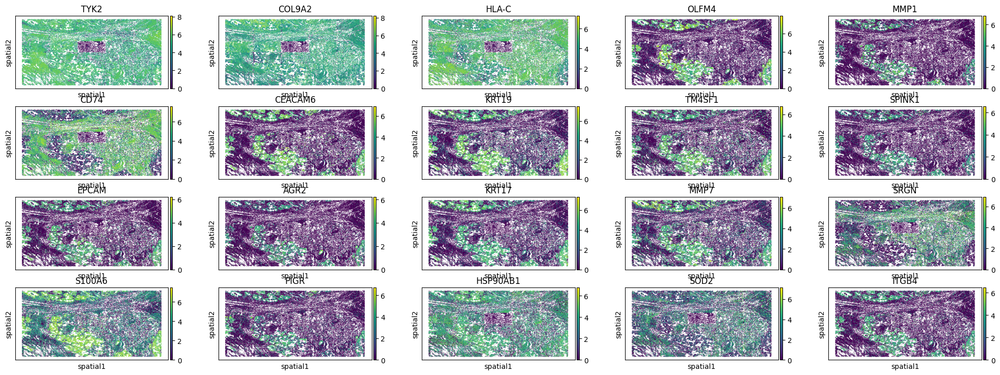

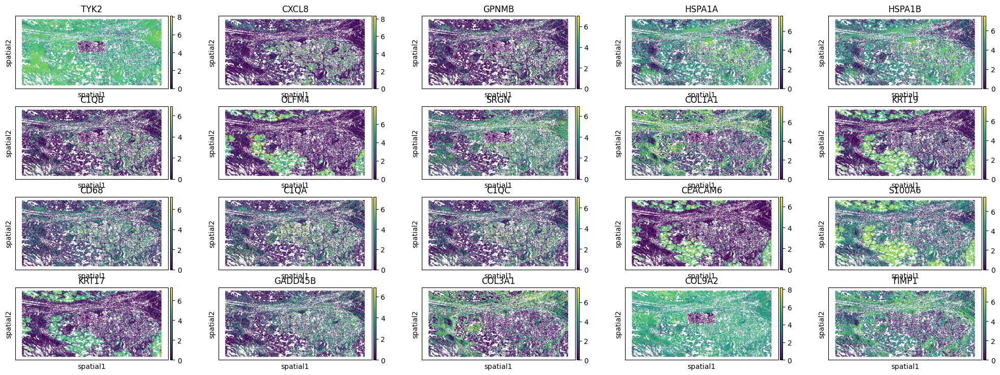

In [106]:
rcParams['figure.figsize'] = (4, 2)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=mean_ratio.sort_values(by='max', ascending=False).head(20).index.values, ncols=5)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=mean_ratio.sort_values(by='mean', ascending=False).head(20).index.values, ncols=5)

### looking only at the borders (compare mean)

In [136]:
ncols = 5
fovs = adata_lung5_r3.obs.fov.unique()
genes = adata_lung5_r3.var_names
mean_ratio = np.zeros((len(genes), len(fovs))) + 1000
var_ratio = np.zeros((len(genes), len(fovs))) + 1000

prop_fov = 0.1

for j, fov in tqdm(enumerate(fovs)):
    
    # define neighbour fovs
    neighbours = [-1, 1, -ncols, ncols]
    if (fov-1)%ncols == 0:
        neighbours.remove(-1)
    if fov%ncols == 0:
        neighbours.remove(1)
    if fov in [x+1 for x in range(ncols)]:
        neighbours.remove(-ncols)
    if fov in [x+1 for x in range(max(fovs)-ncols, max(fovs))]:
        neighbours.remove(ncols)
            
    for relative_n in neighbours:
        n = fov + relative_n
        
        # define cells
        if abs(relative_n) == 1:
            axis = 0 # move along x coordinate
        elif abs(relative_n) == ncols: 
            axis = 1 # move along y coordiante   
        direction = np.sign(relative_n)

        min_coor, max_coor = min(adata_lung5_r3.obsm['spatial'][adata_lung5_r3.obs.fov == fov,axis]), max(adata_lung5_r3.obsm['spatial'][adata_lung5_r3.obs.fov == fov,axis])
        border = direction * max(direction*min_coor, direction*max_coor)

        lim1, lim2 = border, border - direction * (max_coor - min_coor) * prop_fov
        fov_cells = (adata_lung5_r3.obs.fov == fov) & (adata_lung5_r3.obsm['spatial'][:,axis] >= min(lim1, lim2)) & (adata_lung5_r3.obsm['spatial'][:,axis] <= max(lim1, lim2))

        lim1, lim2 = border + direction * (max_coor - min_coor) * prop_fov, border - direction * (max_coor - min_coor) * prop_fov
        fn_cells = (adata_lung5_r3.obs.fov.isin([fov, n])) & (adata_lung5_r3.obsm['spatial'][:,axis] >= min(lim1, lim2)) & (adata_lung5_r3.obsm['spatial'][:,axis] <= max(lim1, lim2))
        
        # compute mean and variance
        mean_ratio[:,j] = np.minimum(mean_ratio[:,j], np.abs(adata_lung5_r3[fn_cells,].X.mean(axis=0) - adata_lung5_r3[fov_cells,].X.mean(axis=0)))
        var_ratio[:,j] = np.minimum(var_ratio[:,j], adata_lung5_r3[fn_cells,].X.var(axis=0)/adata_lung5_r3[fov_cells,].X.var(axis=0))
            
mean_ratio = pd.DataFrame(mean_ratio, index=genes, columns=fovs)
max_mean, mean_mean = mean_ratio.max(axis=1).values, mean_ratio.mean(axis=1).values
mean_ratio['max'], mean_ratio['mean'] = max_mean, mean_mean

var_ratio = pd.DataFrame(var_ratio, index=genes, columns=fovs)
max_var, mean_var = var_ratio.max(axis=1).values, var_ratio.mean(axis=1).values
var_ratio['max'], var_ratio['mean'] = max_var, mean_var

15it [00:00, 26.23it/s]/var/folders/9k/rsnwv_zs49n5zryyfc4myl9d6b36ql/T/ipykernel_23931/2667032333.py:43: RuntimeWarning: divide by zero encountered in divide
  var_ratio[:,j] = np.minimum(var_ratio[:,j], adata_lung5_r3[fn_cells,].X.var(axis=0)/adata_lung5_r3[fov_cells,].X.var(axis=0))
30it [00:01, 26.75it/s]


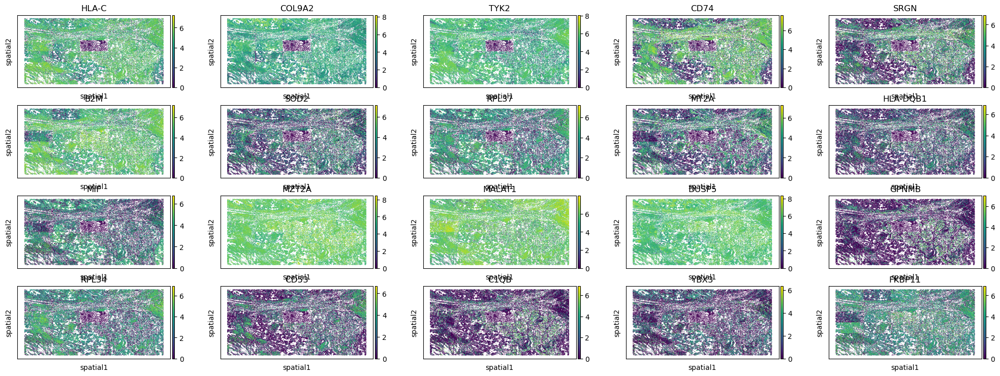

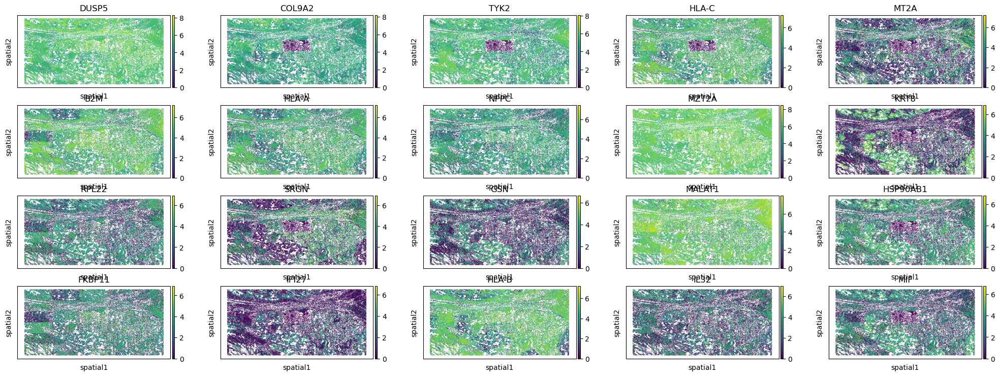

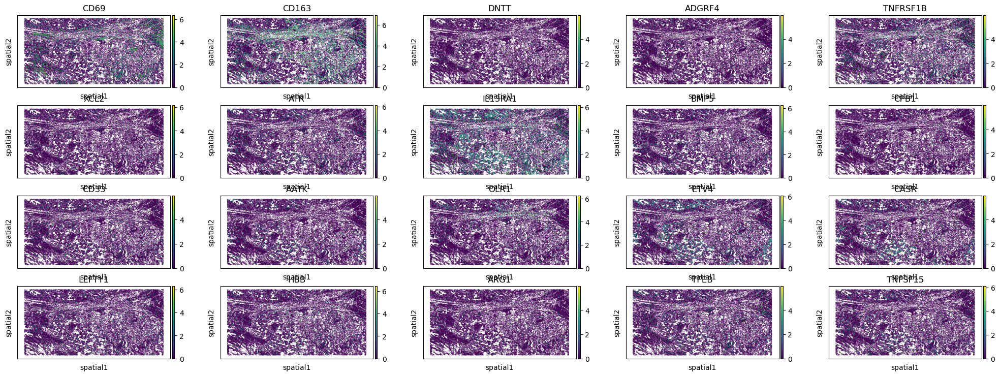

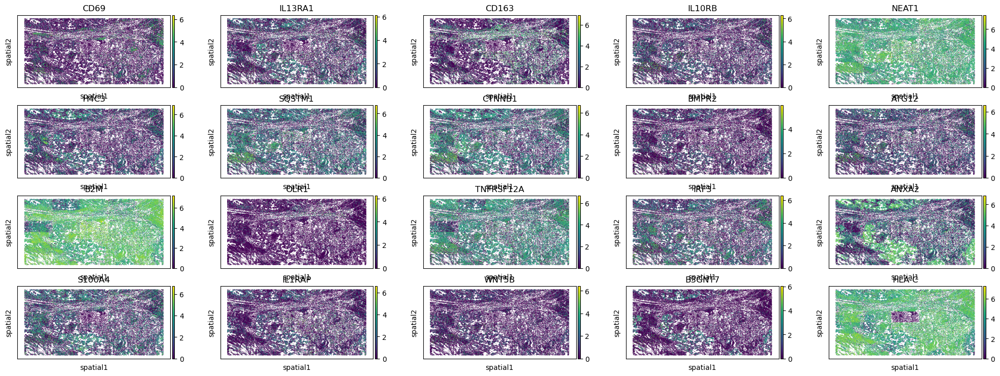

In [120]:
rcParams['figure.figsize'] = (4, 2)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=mean_ratio.sort_values(by='max', ascending=False).head(20).index.values, ncols=5)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=mean_ratio.sort_values(by='mean', ascending=False).head(20).index.values, ncols=5)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=variance_ratio.sort_values(by='max', ascending=False).head(20).index.values, ncols=5)
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=variance_ratio.sort_values(by='mean', ascending=False).head(20).index.values, ncols=5)

<AxesSubplot: >

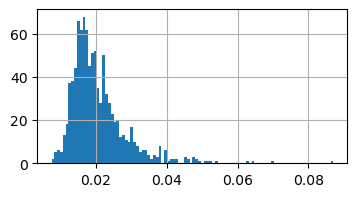

In [137]:
mean_ratio['mean'].hist(bins=100)

In [138]:
mean_ratio.loc[mean_ratio['mean'] > 0.03].index.values

array(['ADGRG3', 'ANXA2', 'B2M', 'C1QB', 'CALM2', 'CD14', 'CD163',
       'CD164', 'CD3E', 'CD53', 'CD63', 'CD74', 'CD81', 'COL1A1',
       'COL9A2', 'CRP', 'CTNNB1', 'CTSG', 'CXCL3', 'DCN', 'DUSP5',
       'FKBP11', 'FN1', 'FOS', 'GNLY', 'GPX1', 'GSN', 'GSTP1', 'HCST',
       'HLA-A', 'HLA-B', 'HLA-C', 'HLA-DQB1', 'HLA-DRB5', 'HSP90AA1',
       'HSP90AB1', 'HSP90B1', 'HSPA1A', 'HSPA1B', 'HSPB1', 'IFI27',
       'IGFBP5', 'IGHG1', 'IGHG2', 'IGKC', 'IL13RA1', 'IL15RA', 'IL18',
       'IL1R1', 'IL32', 'IRF3', 'ITGAV', 'ITGB1', 'ITGB2', 'JUNB', 'KLF2',
       'KRT14', 'KRT18', 'KRT8', 'LGALS3', 'LMNA', 'LUM', 'MALAT1', 'MIF',
       'MMP2', 'MMP7', 'MT2A', 'MZT2A', 'NEAT1', 'NPPC', 'OSMR', 'PSAP',
       'RAMP1', 'RPL21', 'RPL22', 'RPL34', 'RPL37', 'S100A4', 'S100A6',
       'SAT1', 'SOD2', 'SQSTM1', 'SRGN', 'THBS2', 'TIMP1', 'TNFRSF12A',
       'TNFRSF1A', 'TPM2', 'TUBB', 'TYK2', 'VEGFA', 'VIM', 'WIF1', 'XBP1',
       'YBX3'], dtype=object)

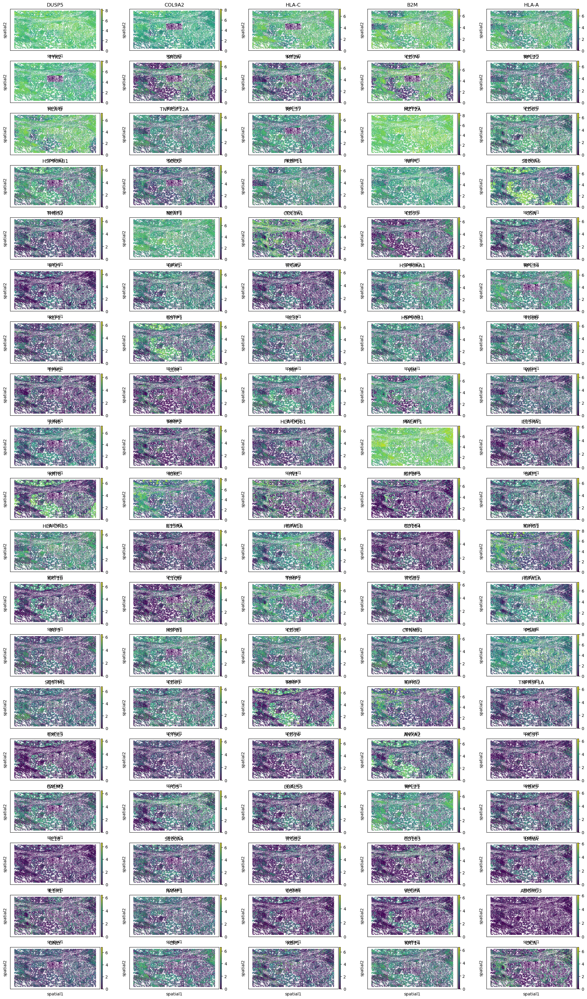

In [139]:
sc.pl.embedding(adata_lung5_r3, basis="spatial", color=mean_ratio.loc[mean_ratio['mean'] > 0.03].sort_values(by='mean', ascending=False).index.values, ncols=5)

<AxesSubplot: >

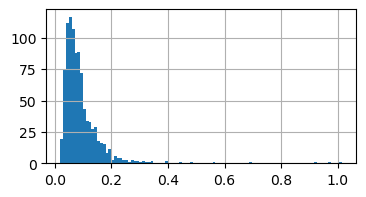

In [127]:
mean_ratio['max'].hist(bins=100)

### all samples

In [169]:
adata.obs['sample'].unique()

['lung9_rep1', 'lung5_rep1', 'lung6', 'lung5_rep3', 'lung12', 'lung13', 'lung9_rep2', 'lung5_rep2']
Categories (8, object): ['lung5_rep1', 'lung5_rep2', 'lung5_rep3', 'lung6', 'lung9_rep1', 'lung9_rep2', 'lung12', 'lung13']

In [193]:
mean_ratio = {}
ncols = 5
prop_fov = 0.1

for rep in adata.obs['sample'].unique():
# for rep in ['lung5_rep1','lung5_rep2','lung5_rep3']:
    subadata = adata[adata.obs['sample'] == rep].copy()
    subadata.raw = subadata
    sc.pp.scale(subadata)
    
    fovs = subadata.obs.fov.unique()
    genes = subadata.var_names
    mean_ratio[rep] = np.zeros((len(genes), len(fovs))) + 1000

    for j, fov in tqdm(enumerate(fovs)):

        # define neighbour fovs
        neighbours = [-1, 1, -ncols, ncols]
        if (fov-1)%ncols == 0:
            neighbours.remove(-1)
        if fov%ncols == 0:
            neighbours.remove(1)
        if fov in [x+1 for x in range(ncols)]:
            neighbours.remove(-ncols)
        if fov in [x+1 for x in range(max(fovs)-ncols, max(fovs))]:
            neighbours.remove(ncols)

        for relative_n in neighbours:
            n = fov + relative_n

            # define cells
            if abs(relative_n) == 1:
                axis = 0 # move along x coordinate
            elif abs(relative_n) == ncols: 
                axis = 1 # move along y coordiante   
            direction = np.sign(relative_n)

            min_coor, max_coor = min(subadata.obsm['spatial'][subadata.obs.fov == fov,axis]), max(subadata.obsm['spatial'][subadata.obs.fov == fov,axis])
            border = direction * max(direction*min_coor, direction*max_coor)

            lim1, lim2 = border, border - direction * (max_coor - min_coor) * prop_fov
            fov_cells = (subadata.obs.fov == fov) & (subadata.obsm['spatial'][:,axis] >= min(lim1, lim2)) & (subadata.obsm['spatial'][:,axis] <= max(lim1, lim2))

            lim1, lim2 = border + direction * (max_coor - min_coor) * prop_fov, border - direction * (max_coor - min_coor) * prop_fov
            fn_cells = (subadata.obs.fov.isin([fov, n])) & (subadata.obsm['spatial'][:,axis] >= min(lim1, lim2)) & (subadata.obsm['spatial'][:,axis] <= max(lim1, lim2))

            # compute mean and variance
            mean_ratio[rep][:,j] = np.minimum(mean_ratio[rep][:,j], np.abs(subadata[fn_cells,].X.mean(axis=0) - subadata[fov_cells,].X.mean(axis=0)))

    mean_ratio[rep] = pd.DataFrame(mean_ratio[rep], index=genes, columns=fovs)
    max_mean, mean_mean = mean_ratio[rep].max(axis=1).values, mean_ratio[rep].mean(axis=1).values
    mean_ratio[rep]['max'], mean_ratio[rep]['mean'] = max_mean, mean_mean

20it [00:00, 73.77it/s]
30it [00:00, 64.83it/s]
30it [00:00, 71.24it/s]
30it [00:00, 69.22it/s]
28it [00:00, 78.72it/s]
20it [00:00, 70.85it/s]
45it [00:00, 65.68it/s]
29it [00:00, 61.16it/s]


In [194]:
all_mean_mean_ratio = pd.DataFrame({rep: mean_ratio[rep]['mean'] for rep in mean_ratio})
all_mean_mean_ratio['n_high'] = (all_mean_mean_ratio > 0.025).sum(axis=1).values
all_mean_mean_ratio['mean'] = all_mean_mean_ratio.iloc[:,0:-1].mean(axis=1).values

In [195]:
all_mean_mean_ratio.sort_values(by='mean', ascending=False).head(20)

,lung9_rep1,lung5_rep1,lung6,lung5_rep3,lung12,lung13,lung9_rep2,lung5_rep2,n_high,mean
TYK2,0.029645,0.047733,0.143945,0.052627,0.014104,0.021110,0.022589,0.020769,4,0.044065
DUSP5,0.030031,0.042185,0.077022,0.087051,0.023680,0.028290,0.015104,0.035920,6,0.042410
MZT2A,0.019853,0.036614,0.097003,0.047686,0.023975,0.028925,0.028037,0.028046,6,0.038767
B2M,0.014026,0.028704,0.090871,0.062830,0.013043,0.021058,0.020819,0.019379,3,0.033841
HSP90AB1,0.030655,0.022057,0.081664,0.045920,0.009713,0.028544,0.024973,0.023971,4,0.033437
HLA-B,0.022806,0.030253,0.068625,0.048137,0.016404,0.026625,0.017734,0.034757,5,0.033167
COL9A2,0.014520,0.020830,0.076436,0.069797,0.014468,0.013948,0.026048,0.024890,3,0.032617
HLA-A,0.030848,0.024461,0.052681,0.054275,0.016279,0.029512,0.021655,0.022572,4,0.031535
GSTP1,0.026683,0.025569,0.074960,0.039502,0.017979,0.012547,0.029730,0.023987,5,0.031370
HLA-C,0.020559,0.027042,0.044675,0.064569,0.012380,0.019603,0.022759,0.026441,4,0.029754


<AxesSubplot: >

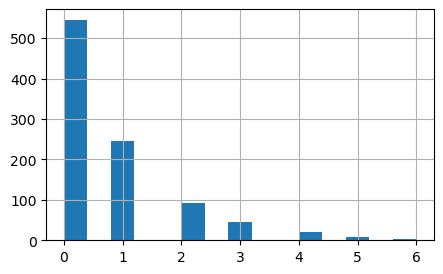

In [196]:
all_mean_mean_ratio['n_high'].hist(bins=15)

In [197]:
all_mean_mean_ratio[all_mean_mean_ratio['n_high'] > 2].index

Index(['AKT1', 'ANXA2', 'B2M', 'C1QC', 'CALM2', 'CD3E', 'CD63', 'CD74', 'CD81',
       'CLDN4', 'COL1A1', 'COL3A1', 'COL6A1', 'COL6A2', 'COL9A2', 'CRP',
       'CTNNB1', 'DCN', 'DUSP5', 'EIF5A', 'FKBP11', 'GLUL', 'GPNMB', 'GPX1',
       'GSTP1', 'HLA-A', 'HLA-B', 'HLA-C', 'HLA-DRB5', 'HLA-E', 'HSP90AA1',
       'HSP90AB1', 'HSP90B1', 'HSPA1A', 'HSPA1B', 'HSPB1', 'IFI27', 'IFITM3',
       'IGFBP5', 'IGHG1', 'IGHG2', 'IGKC', 'ITGB8', 'JUN', 'JUNB', 'KRT14',
       'KRT19', 'KRT8', 'MALAT1', 'MIF', 'MT2A', 'MZT2A', 'NDRG1', 'NEAT1',
       'RPL21', 'RPL22', 'RPL32', 'RPL34', 'RPL37', 'S100A10', 'S100A4',
       'S100A6', 'S100A9', 'SAT1', 'SERPINA1', 'SLPI', 'SOD2', 'SOX9',
       'SQSTM1', 'TACSTD2', 'TAGLN', 'THBS2', 'TIMP1', 'TM4SF1', 'TUBB',
       'TYK2', 'VEGFA'],
      dtype='object')

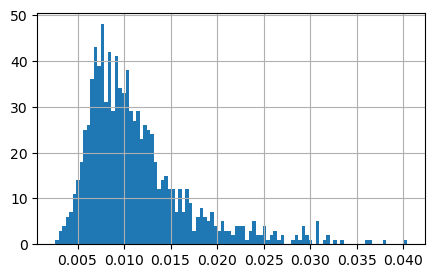

['IFITM1' 'GPX1' 'HSP90B1' 'CLDN4' 'CD24' 'KRT19' 'IFI27' 'CD63' 'JAG1'
 'SLPI' 'HLA-A' 'BCL2' 'IFITM3' 'HSP90AB1' 'DUSP5' 'TYK2' 'TACSTD2'
 'RPL22' 'DDR1' 'FGFR1']


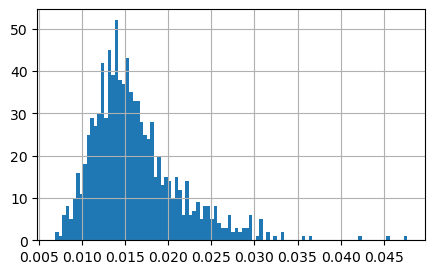

['TYK2' 'RPL21' 'DUSP5' 'MZT2A' 'IGHG2' 'S100A9' 'PIGR' 'JUNB' 'HSPB1'
 'RPL34' 'HLA-DRB5' 'NEAT1' 'IGHG1' 'ITGA1' 'ANXA2' 'HLA-B' 'TAGLN' 'CRP'
 'RPL32' 'CXCR4']


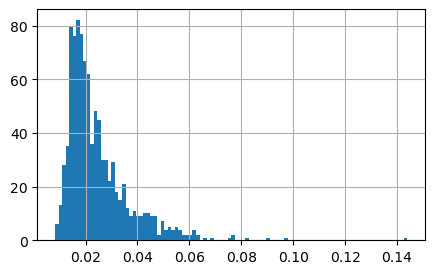

['TYK2' 'MZT2A' 'B2M' 'HSP90AB1' 'DUSP5' 'COL9A2' 'GSTP1' 'HLA-B' 'PSAP'
 'LAMP2' 'MTRNR2L1' 'C9orf16' 'CALM2' 'NPPC' 'STAT3' 'CTNNB1' 'S100A6'
 'FKBP11' 'COL4A2' 'KRT17']


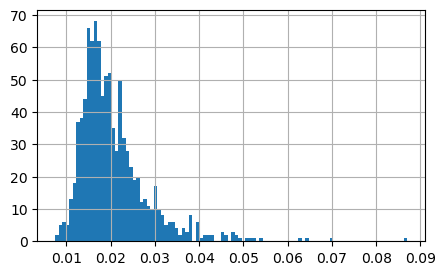

['DUSP5' 'COL9A2' 'HLA-C' 'B2M' 'HLA-A' 'TYK2' 'SRGN' 'MT2A' 'CD74'
 'RPL22' 'HLA-B' 'TNFRSF12A' 'RPL37' 'MZT2A' 'CD63' 'HSP90AB1' 'SOD2'
 'FKBP11' 'NPPC' 'S100A6']


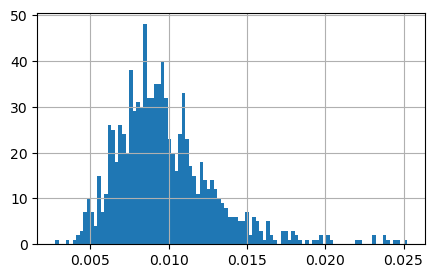

['TAGLN' 'SERPINA1' 'FN1' 'MZT2A' 'PTGDR2' 'DUSP5' 'IGKC' 'MALAT1' 'BGN'
 'IGHA1' 'PSAP' 'COL5A1' 'IGFBP7' 'PHLDA2' 'CRP' 'EPHA2' 'WIF1' 'FKBP11'
 'HLA-DRB1' 'COL18A1']


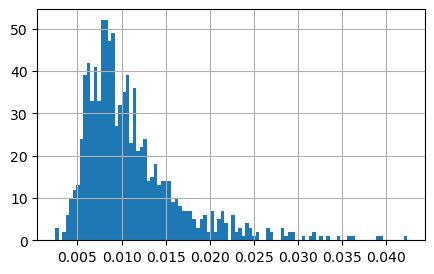

['DCN' 'COL3A1' 'COL1A1' 'IL32' 'CXCL9' 'GPNMB' 'MT2A' 'SQSTM1' 'KRT8'
 'RPL22' 'NFKBIA' 'TAGLN' 'HLA-A' 'RAC1' 'MZT2A' 'SERPINA1' 'HSP90AB1'
 'DUSP5' 'TUBB' 'HLA-DQA1']


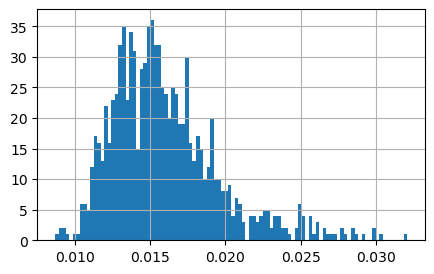

['JUN' 'SOX4' 'SLPI' 'GSTP1' 'EPHA4' 'MIF' 'NDRG1' 'IFITM1' 'MZT2A' 'SOX9'
 'IGFBP3' 'KRT8' 'HSPB1' 'CXCL10' 'RPL37' 'VEGFA' 'HLA-E' 'HSP90AA1'
 'COL9A2' 'MX1']


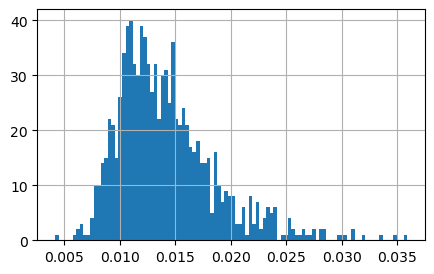

['DUSP5' 'HLA-B' 'MT2A' 'HLA-DRB5' 'THBS2' 'SAT1' 'RPL22' 'IGHG2' 'IGHG1'
 'COL3A1' 'IGKC' 'IGFBP7' 'MZT2A' 'COL6A2' 'FKBP11' 'TIMP1' 'SERPINA1'
 'RPL37' 'HLA-C' 'ITGB6']


In [198]:
for rep in mean_ratio:
    all_mean_mean_ratio[rep].hist(bins=100)
    plt.show()
    print(all_mean_mean_ratio.sort_values(by=rep, ascending=False).head(20).index.values)